In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
import datetime
from datetime import datetime, timedelta
import json
import itertools
from tqdm import tqdm
import os
os.chdir("/content/drive/MyDrive/projects/Store_Sales-Time_Series_Forecasting/")
import lightgbm as lgb

In [2]:
conf = json.load(open("config/config_lgbm.json"))
cutoffs = conf["periods"]
all_params = [
    dict(zip(conf["cv_params"].keys(), v)) for v in itertools.product(*conf["cv_params"].values())
]
conf

{'model': 'LightGBM',
 'cv_params': {'max_bin': [100, 200, 300],
  'boosting': ['gbdt', 'dart'],
  'max_depth': [3, 4, 5, 6, 7, 8],
  'objective': ['regression'],
  'learning_rate': [0.01]},
 'params': {},
 'periods': [{'end': '2017-05-31', 'start': '2017-04-21'},
  {'end': '2017-06-30', 'start': '2017-06-01'},
  {'end': '2017-07-31', 'start': '2017-07-01'}],
 'train_start': '2017-04-21',
 'train_end': '2017-07-31',
 'test_start': '2017-08-01',
 'test_end': '2017-08-15',
 'sub-train_start': '2017-04-21',
 'sub-train_end': '2017-08-15',
 'sub_start': '2017-08-16',
 'sub_end': '2017-08-31',
 'features': ['demand', 'shift_holiday', 'shift_max_temperature'],
 'exclude_features': ['avg_oil'],
 'categorical_features': [],
 'loss': 'l2',
 'random_seed': 13}

In [3]:
# 特徴量
df_add_f = pd.read_csv("store-sales-time-series-forecasting/train_upgini.csv", index_col=0, parse_dates=True)
df_add_f = df_add_f.loc["2017-04-21":]
# 使う特徴量を選択
ex_features = conf["exclude_features"]
df_add_f = df_add_f.drop(ex_features, axis=1)
df_add_f.head()

,dcoilwtico,dayofweek_cos,dayofweek_sin,wd,type_Additional,type_Bridge,type_Event,type_Holiday,type_Transfer,type_Work Day,wageday,school_season,f_year_cos1_cd165f8c,f_year_cos3_8db0059c,f_finance_umap_4_d6d95b66,f_mlending_approve_score_d4c33397
date,,,,,,,,,,,,,,,,
2017-04-21,49.640000,-0.222521,-9.749279e-01,1,0,0,0,0,0,0,0,1,-0.474951,0.996298,5.773014,0.383328
2017-04-22,49.393333,0.623490,-7.818315e-01,0,0,0,0,0,0,0,0,1,-0.490029,0.999407,5.815888,0.279096
2017-04-23,49.146667,1.000000,-2.449294e-16,0,0,0,0,0,0,0,0,1,-0.504961,0.999852,5.821791,0.291966
2017-04-24,48.900000,0.623490,7.818315e-01,1,0,0,0,0,0,0,0,1,-0.519744,0.997630,5.806848,0.403509
2017-04-25,49.220000,-0.222521,9.749279e-01,1,0,0,0,0,0,0,0,1,-0.534373,0.992749,9.111323,0.384689


In [4]:
# trainデータ
df_train = pd.read_csv("store-sales-time-series-forecasting/train.csv", index_col=1, parse_dates=True)
df_train.head()

,id,store_nbr,family,sales,onpromotion
date,,,,,
2013-01-01,0,1,AUTOMOTIVE,0.0,0
2013-01-01,1,1,BABY CARE,0.0,0
2013-01-01,2,1,BEAUTY,0.0,0
2013-01-01,3,1,BEVERAGES,0.0,0
2013-01-01,4,1,BOOKS,0.0,0


In [5]:
df_test = pd.read_csv("store-sales-time-series-forecasting/test.csv", index_col=1, parse_dates=True)
df_test.head()

,id,store_nbr,family,onpromotion
date,,,,
2017-08-16,3000888,1,AUTOMOTIVE,0
2017-08-16,3000889,1,BABY CARE,0
2017-08-16,3000890,1,BEAUTY,2
2017-08-16,3000891,1,BEVERAGES,20
2017-08-16,3000892,1,BOOKS,0


In [6]:
def walk_forward_validation(df_X, df_y , cutoffs, params):
  indexes = []
  y_vals = []
  y_preds =[]  
  for i in range(len(cutoffs)-1):
    train_start = cutoffs[i]["start"]
    train_end = cutoffs[i]["end"]
    val_start = cutoffs[i+1]["start"]
    val_end = cutoffs[i+1]["end"]

    X_train = df_X.loc[train_start : train_end]
    y_train = df_y.loc[train_start : train_end]
    X_val = df_X.loc[val_start : val_end]
    y_val = df_y.loc[val_start : val_end] 
    y_vals.extend(y_val)
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_val, y_val, reference=lgb_train)

    model = lgb.train(
        params, lgb_train, valid_sets=[lgb_train, lgb_eval],
        verbose_eval=0,
        num_boost_round=1000,
        early_stopping_rounds=10
        )

    y_preds.extend(model.predict(X_val, num_iteration=model.best_iteration))
    indexes.extend(df_y.loc[val_start : val_end].index)

  df_cv = pd.DataFrame({"y" : y_vals, "y_pred" : y_preds}, index=indexes)
  return df_cv

In [7]:
from sklearn.metrics import mean_squared_log_error
import warnings

result = []
sub = []
warnings.simplefilter(action='ignore', category=UserWarning)
for family in tqdm(df_train["family"].unique()):
  for nbr in df_train["store_nbr"].unique():
    df_y = df_train.query(" (family==@family) & (store_nbr==@nbr) ").sales
    rmsles = []
    for params in all_params:
      #params.update(com_params)
      df_cv = walk_forward_validation(df_add_f, df_y , cutoffs, params)

      y_true = df_cv["y"]
      y_pred = df_cv["y_pred"]
      y_pred[y_pred<0] = 0 # 予測が0未満の場合は0に置換

      rmsles.append(mean_squared_log_error(y_true, y_pred, squared=False))
    
    best_params = pd.DataFrame({"all_params" : all_params, "rmsles" : rmsles}).sort_values("rmsles").iloc[0].to_list()
    best_params.extend([family, nbr])
    result.append(best_params)

100%|██████████| 33/33 [6:21:22<00:00, 693.42s/it]


In [8]:
# df_resultに評価データでの指標を記録
df_result = pd.DataFrame(result)
df_result.columns = ["params", "val_RMSLE", "family", "store_nbr"]
df_result = df_result.sort_values(["store_nbr", "family"])
df_result = df_result.reset_index(drop=True)
df_result.head()

,params,val_RMSLE,family,store_nbr
0,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.638531,AUTOMOTIVE,1
1,"{'max_bin': 100, 'boosting': 'gbdt', 'max_dept...",0.000000,BABY CARE,1
2,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.463600,BEAUTY,1
3,"{'max_bin': 100, 'boosting': 'gbdt', 'max_dept...",0.279483,BEVERAGES,1
4,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.429000,BOOKS,1


In [9]:
# 全体の平均
val_rmsle = df_result["val_RMSLE"].mean()
print(val_rmsle)
df_result.groupby(["family"]).mean().sort_values("val_RMSLE", ascending=False)

0.4023878390649301


,val_RMSLE,store_nbr
family,,
"LIQUOR,WINE,BEER",0.678859,27.5
LINGERIE,0.649488,27.5
CELEBRATION,0.593309,27.5
GROCERY II,0.576332,27.5
BEAUTY,0.546765,27.5
HARDWARE,0.538371,27.5
AUTOMOTIVE,0.534648,27.5
SEAFOOD,0.531396,27.5
HOME AND KITCHEN I,0.528553,27.5


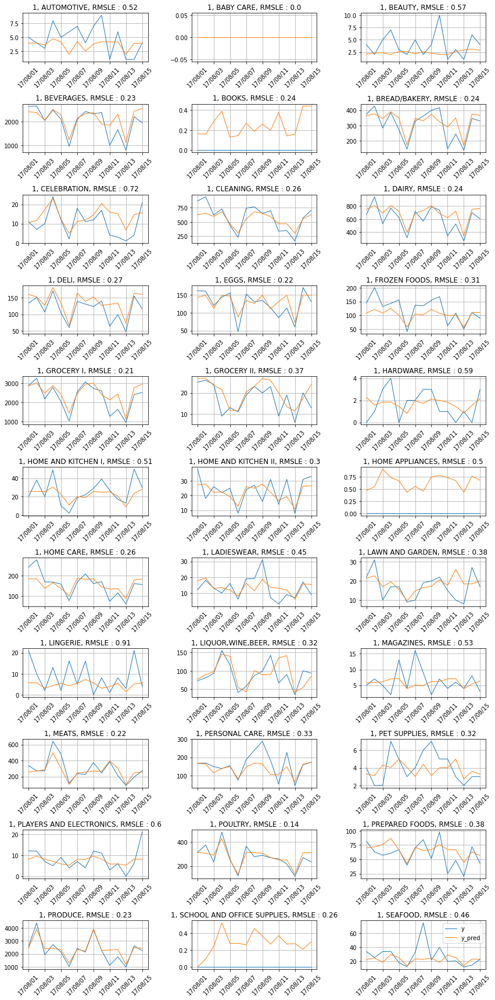

******************************


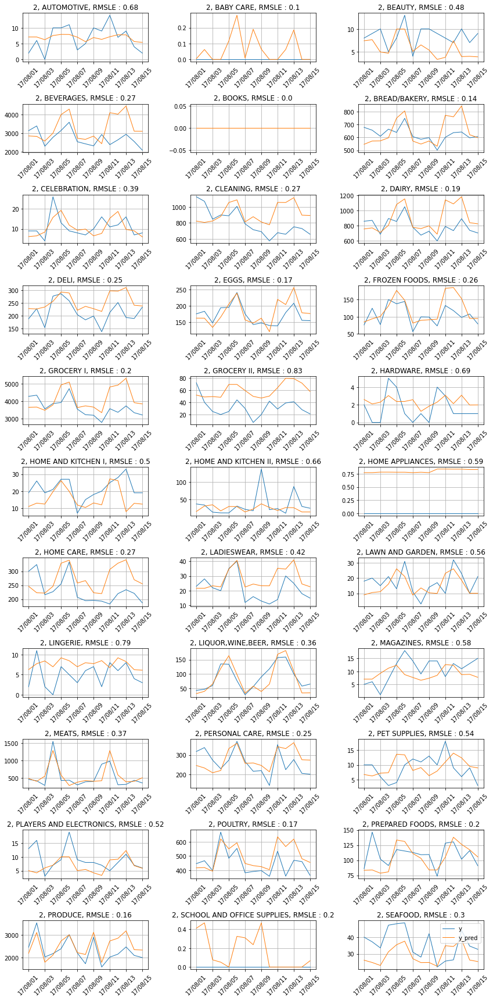

******************************


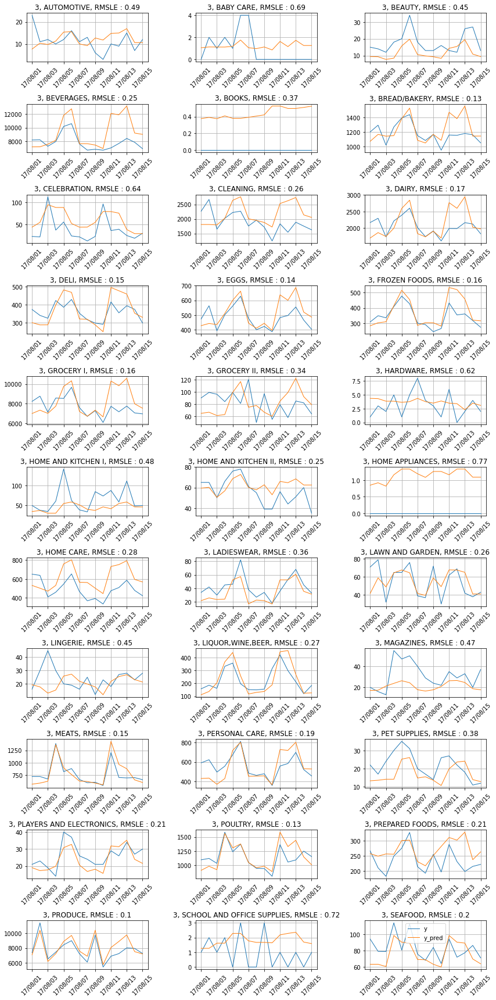

******************************


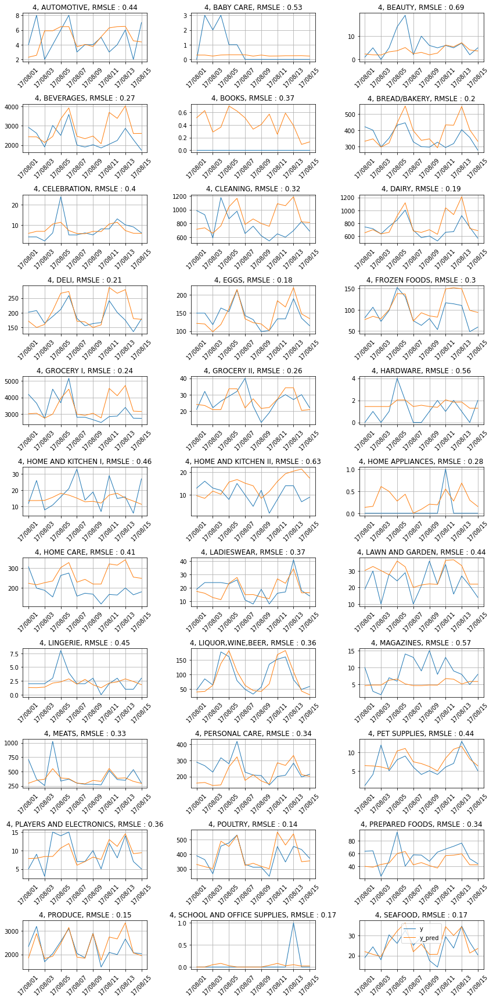

******************************


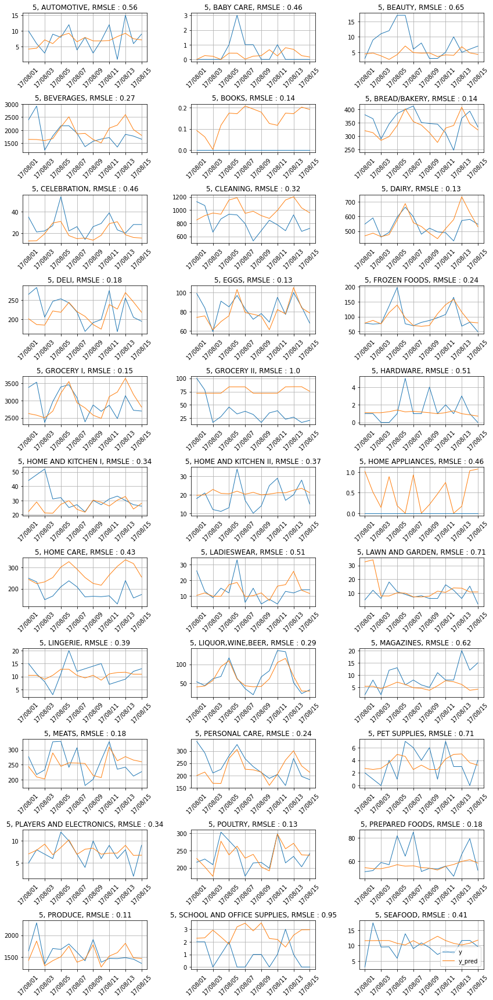

******************************


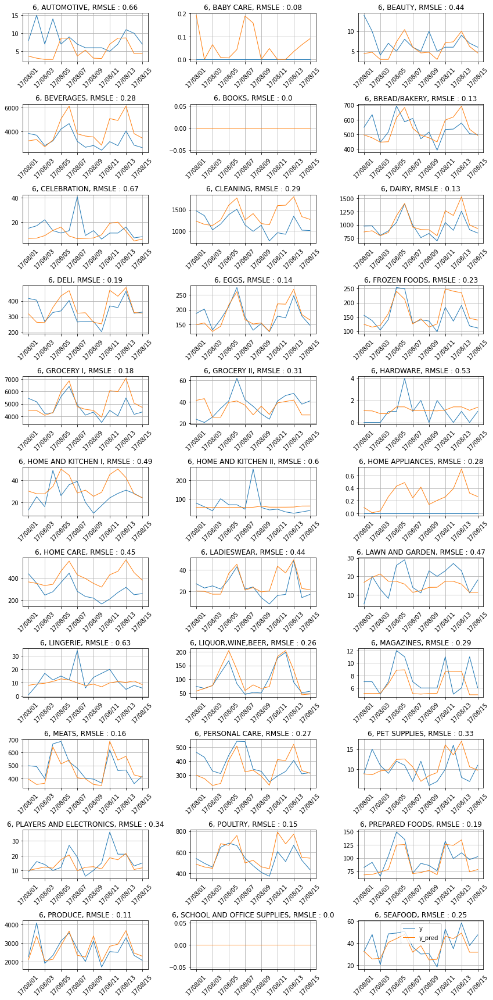

******************************


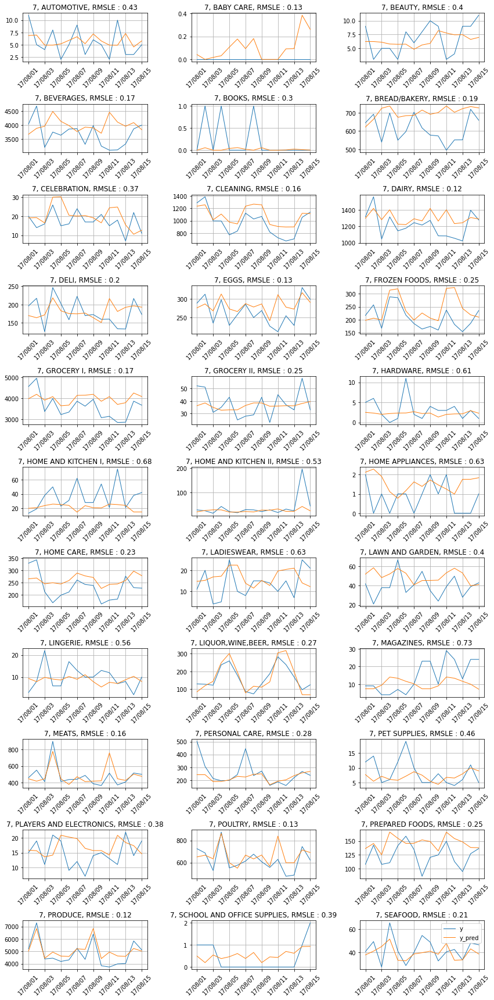

******************************


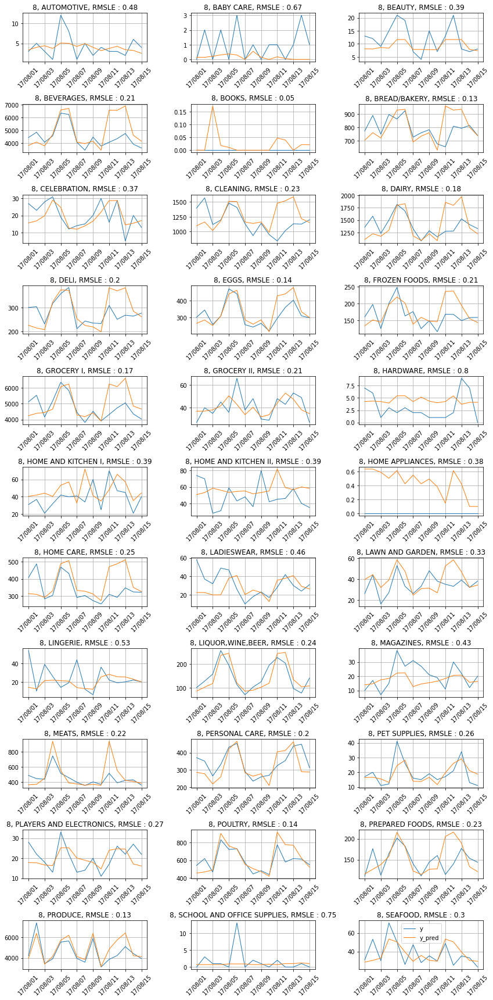

******************************


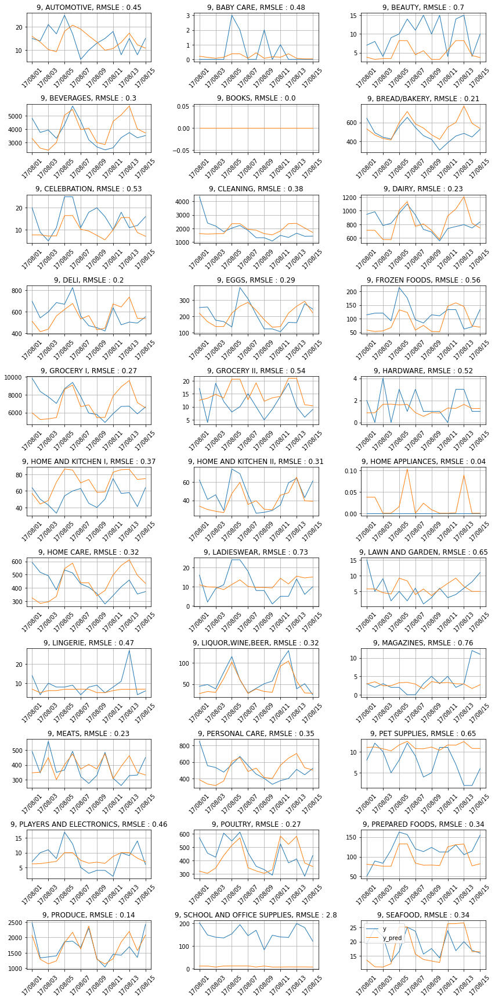

******************************


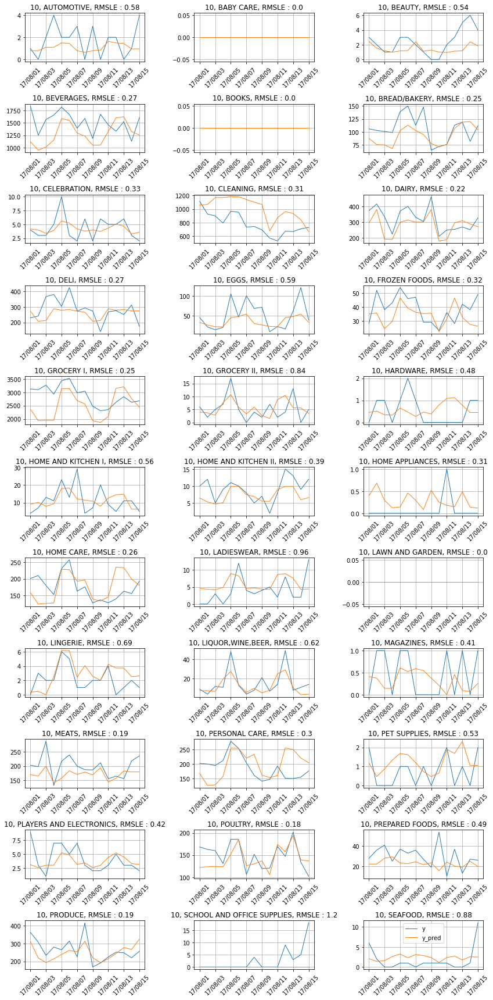

******************************


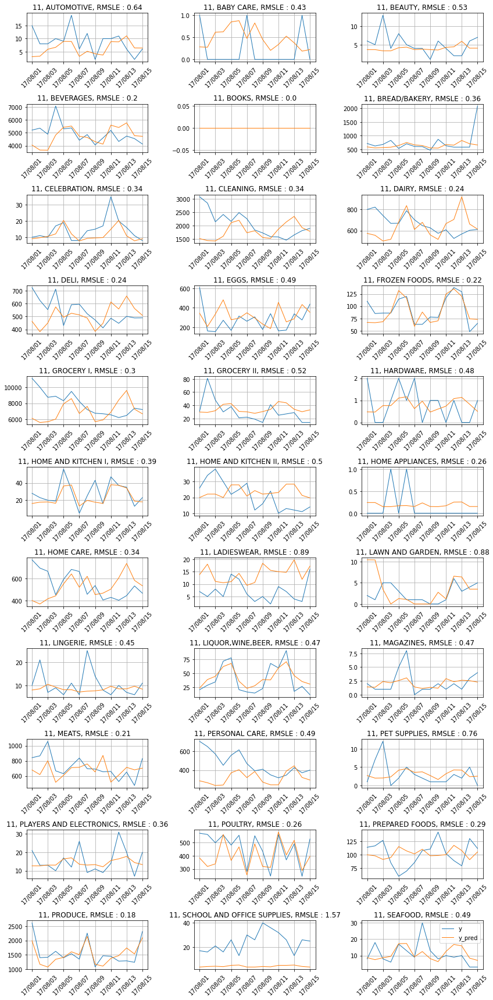

******************************


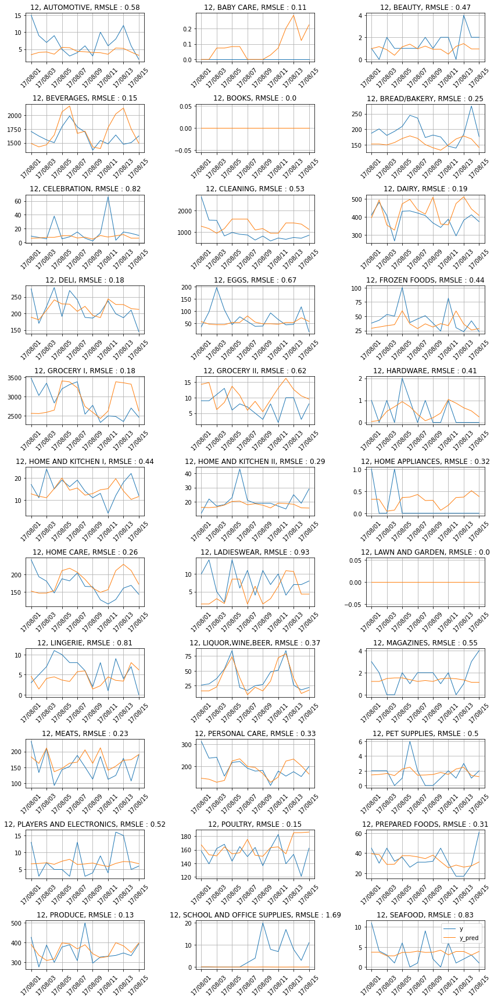

******************************


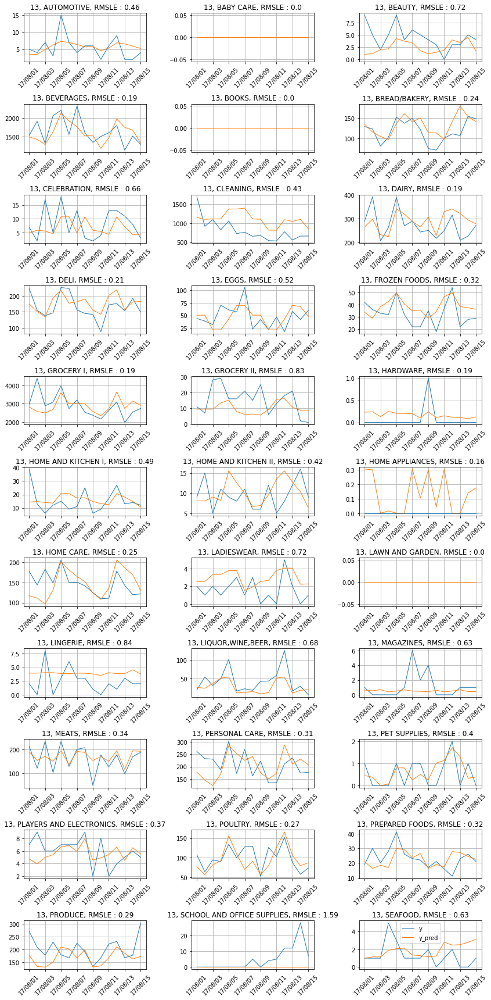

******************************


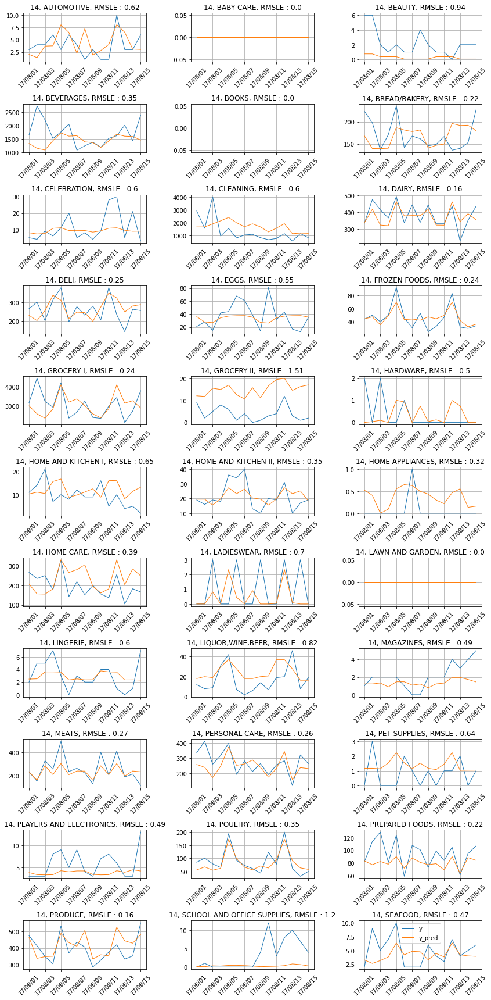

******************************


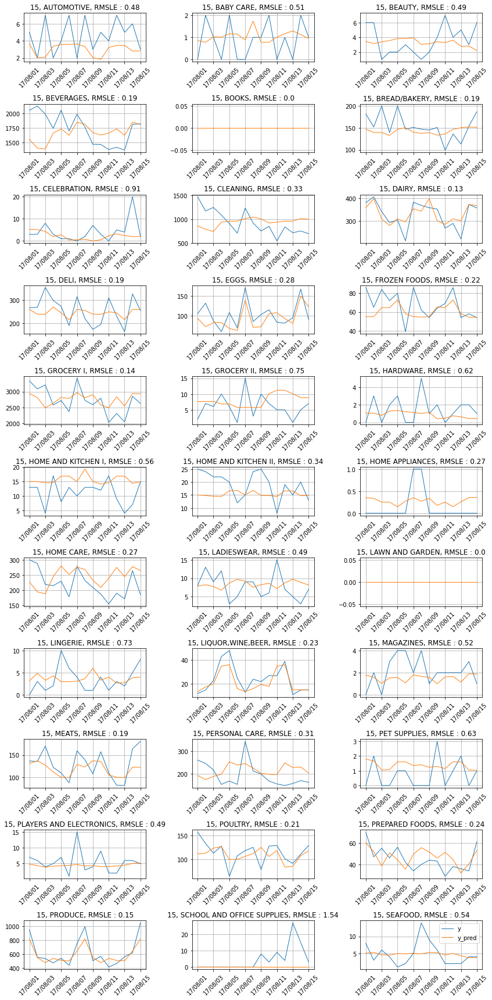

******************************


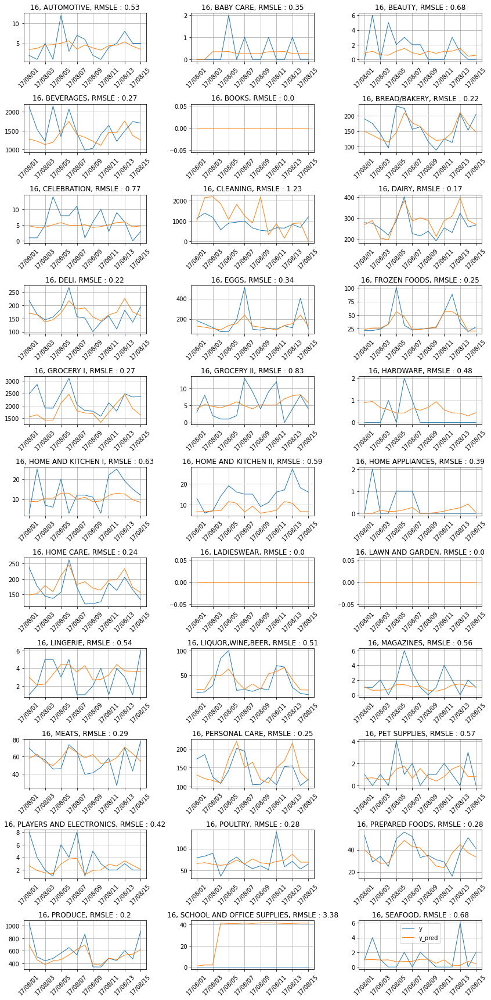

******************************


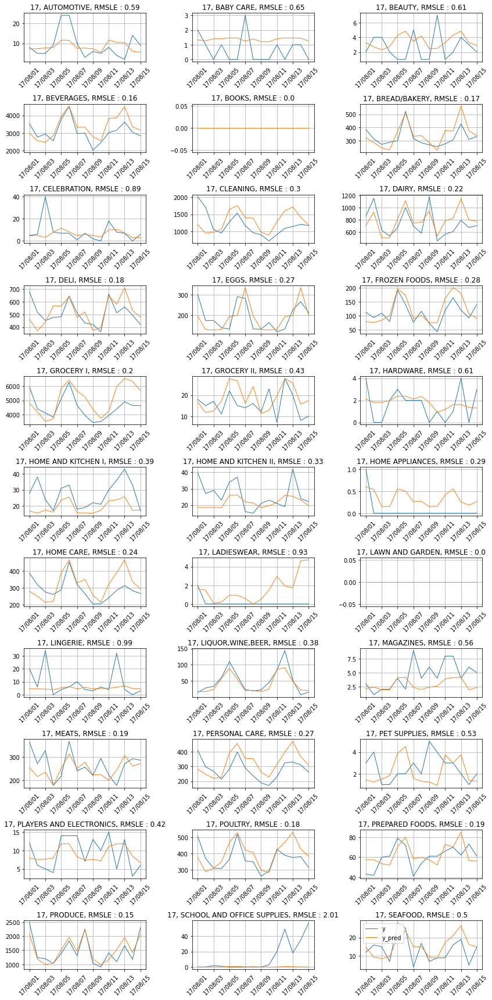

******************************


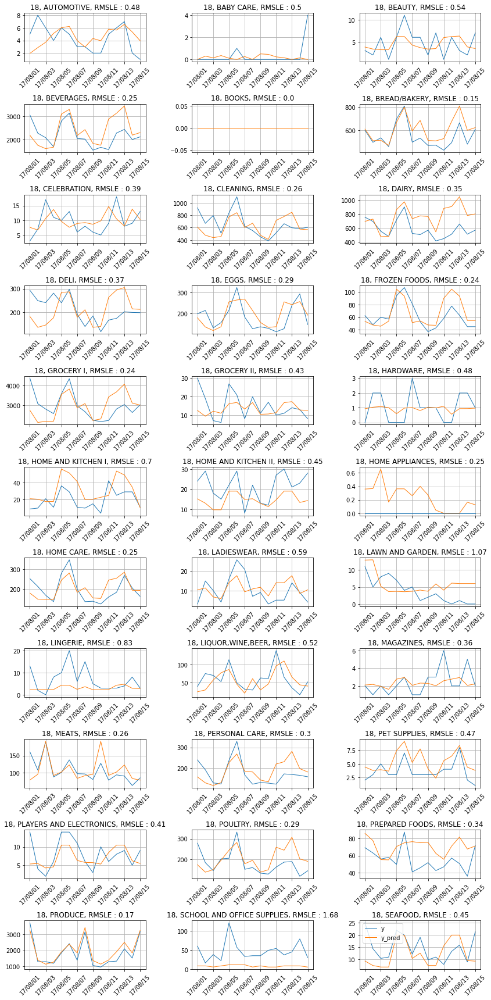

******************************


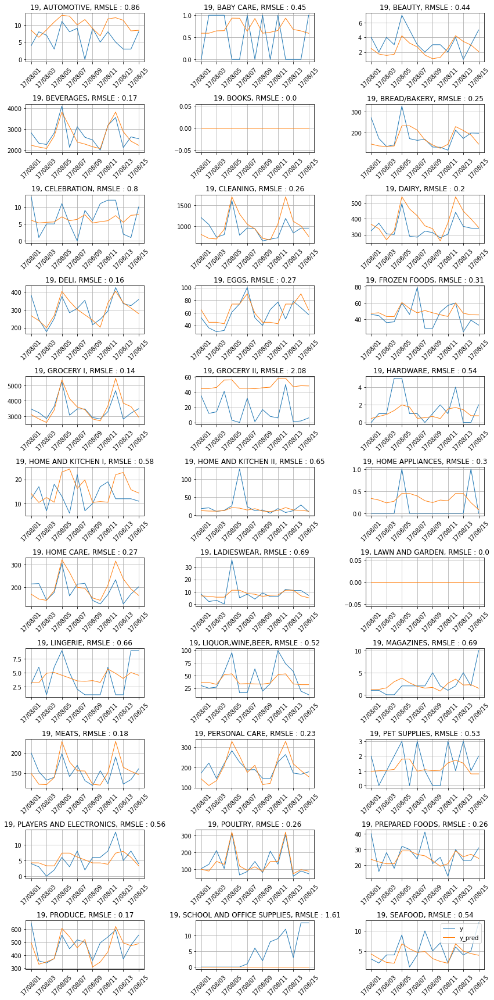

******************************


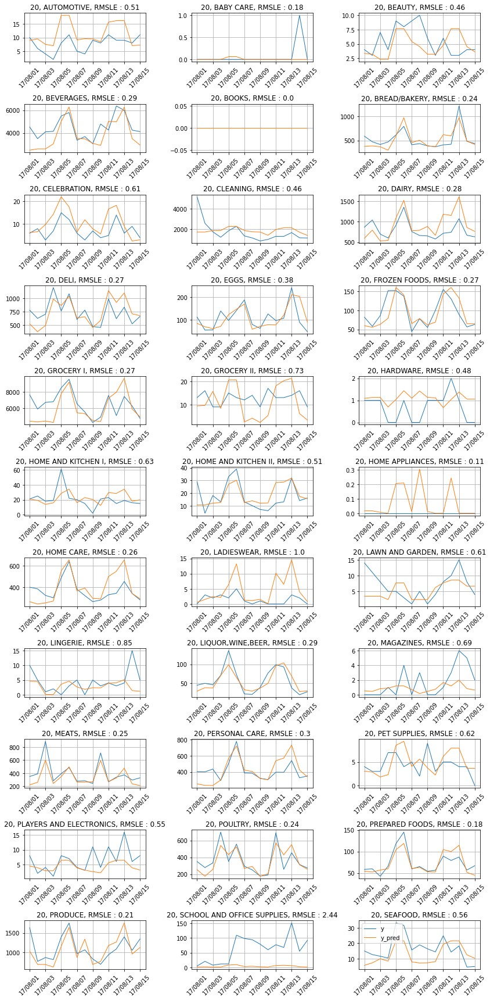

******************************


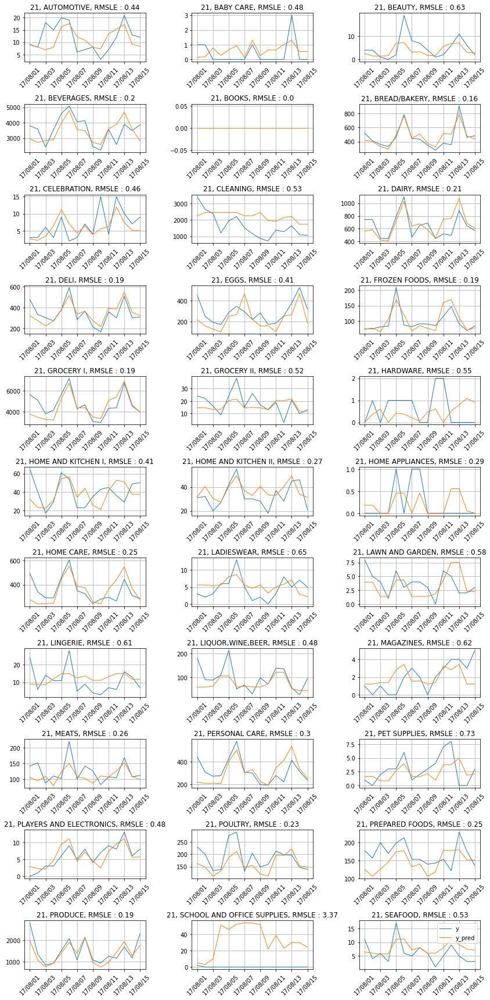

******************************


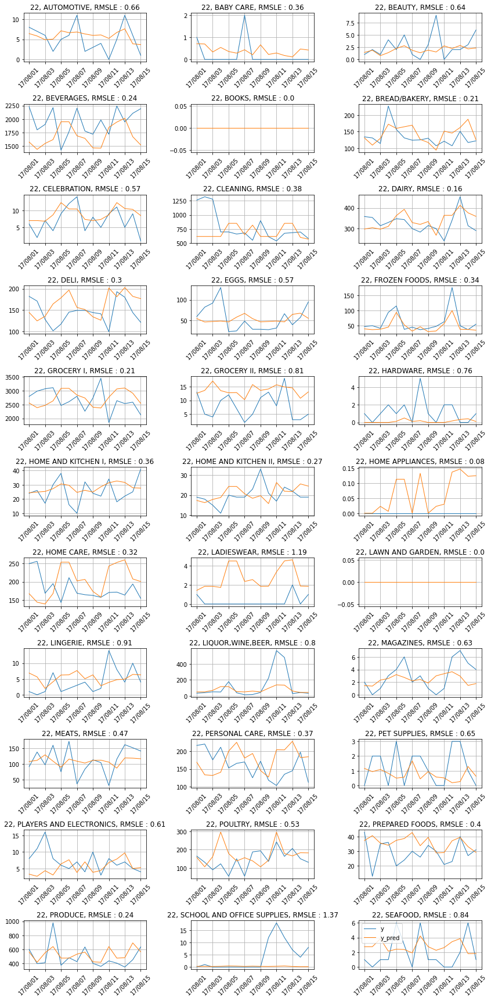

******************************


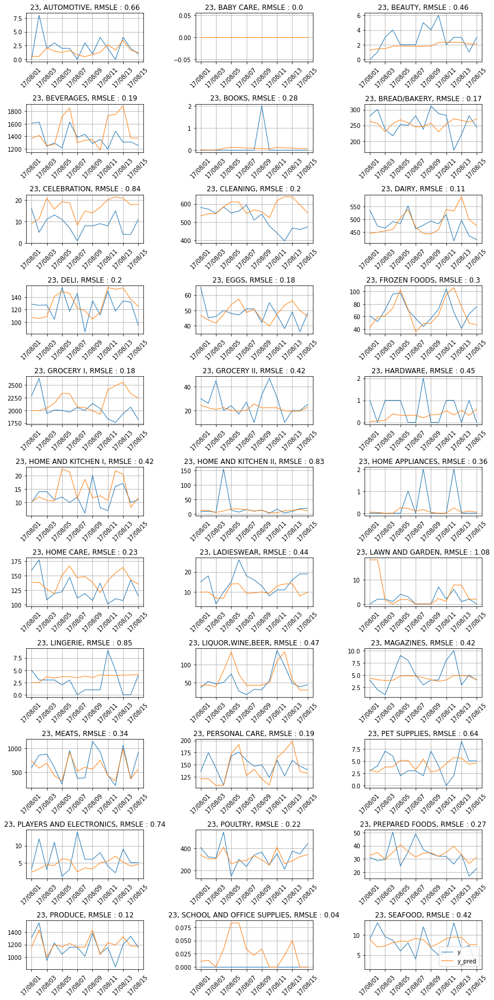

******************************


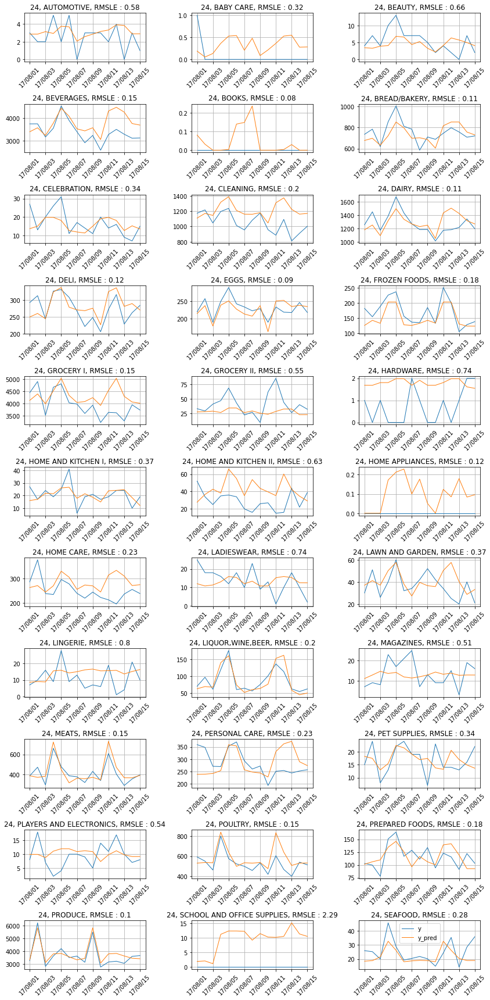

******************************


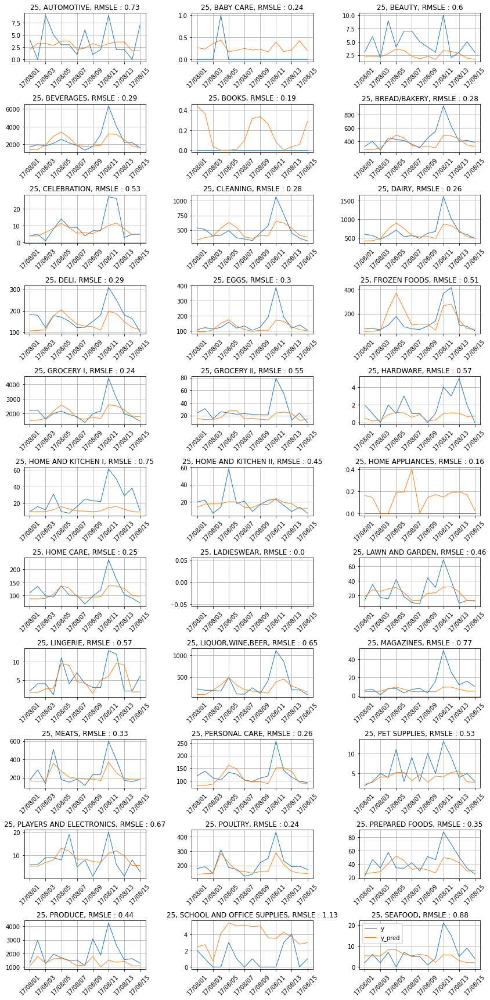

******************************


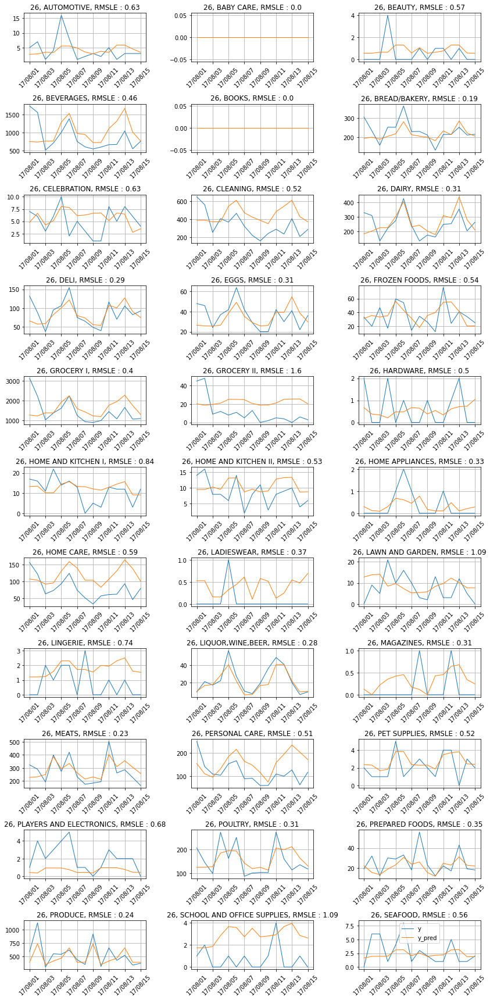

******************************


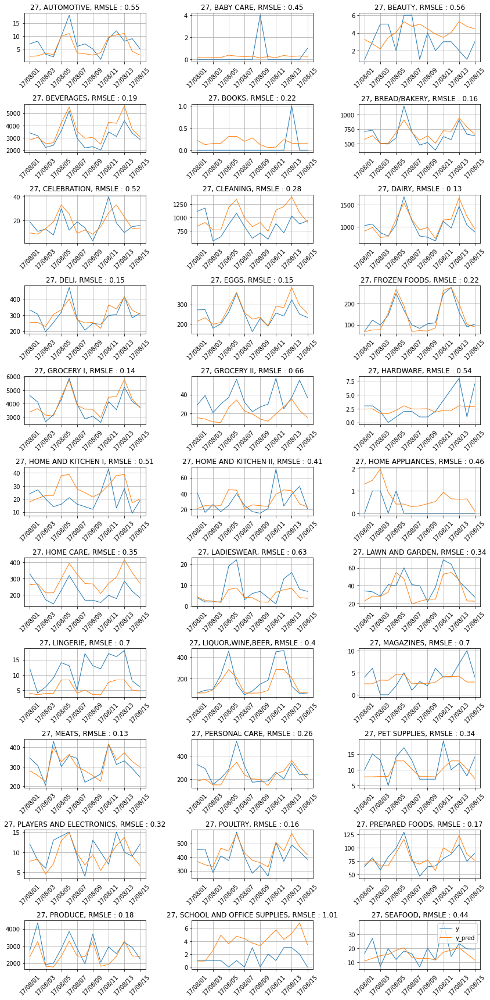

******************************


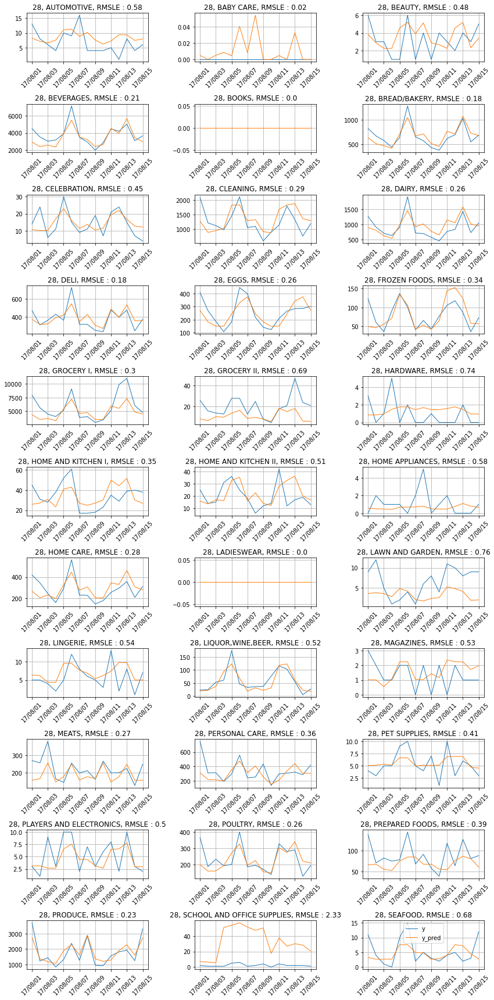

******************************


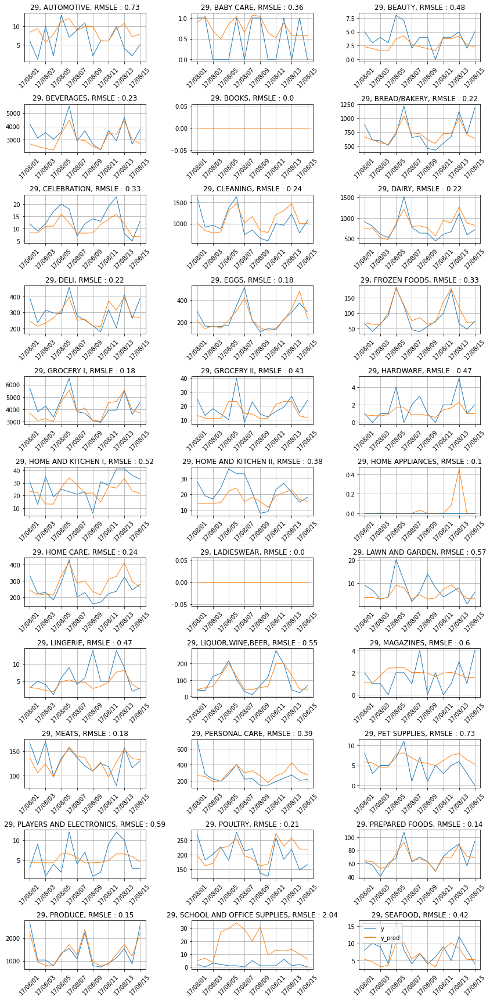

******************************


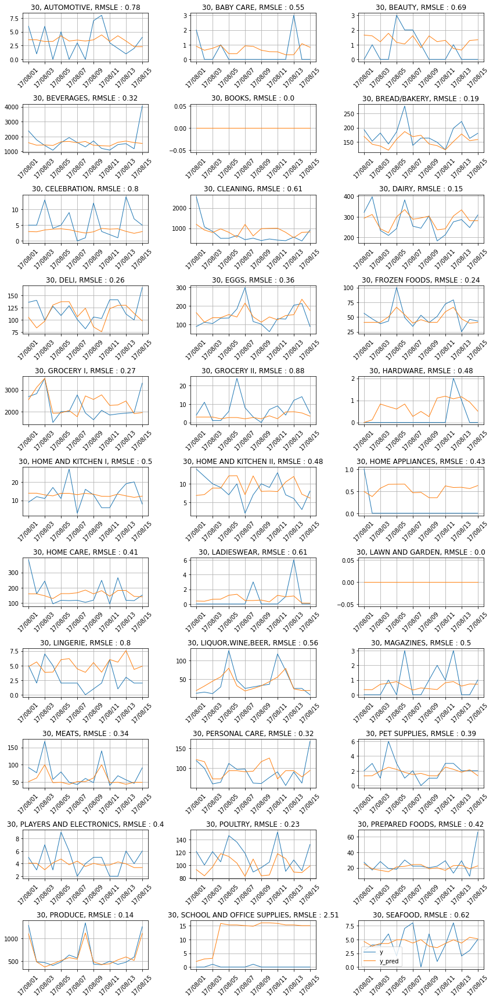

******************************


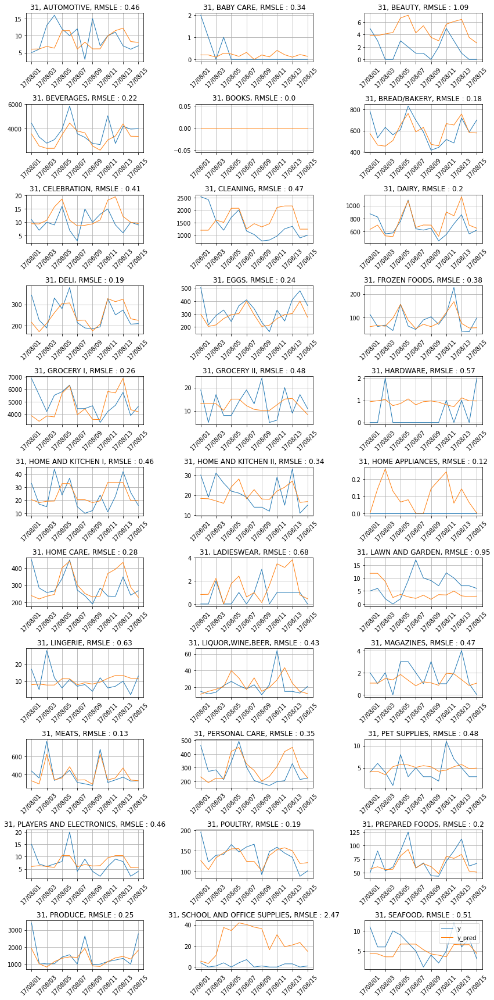

******************************


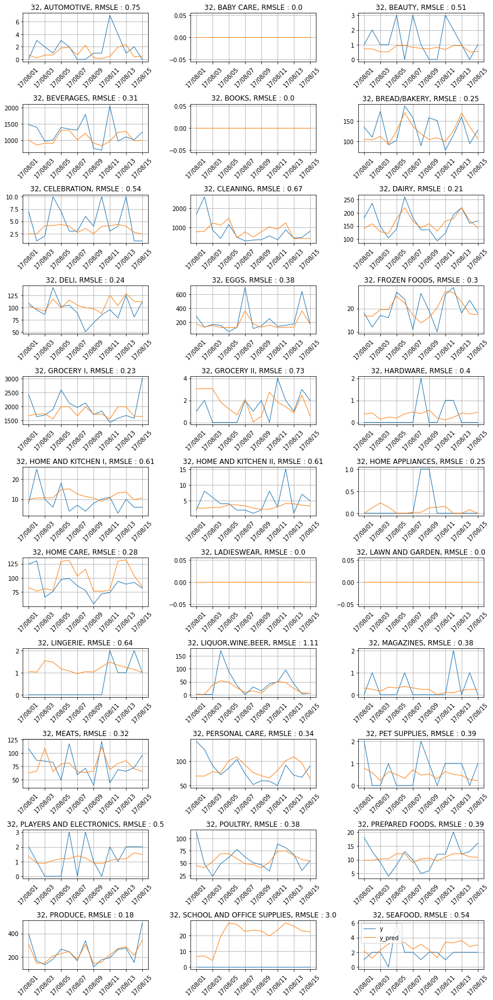

******************************


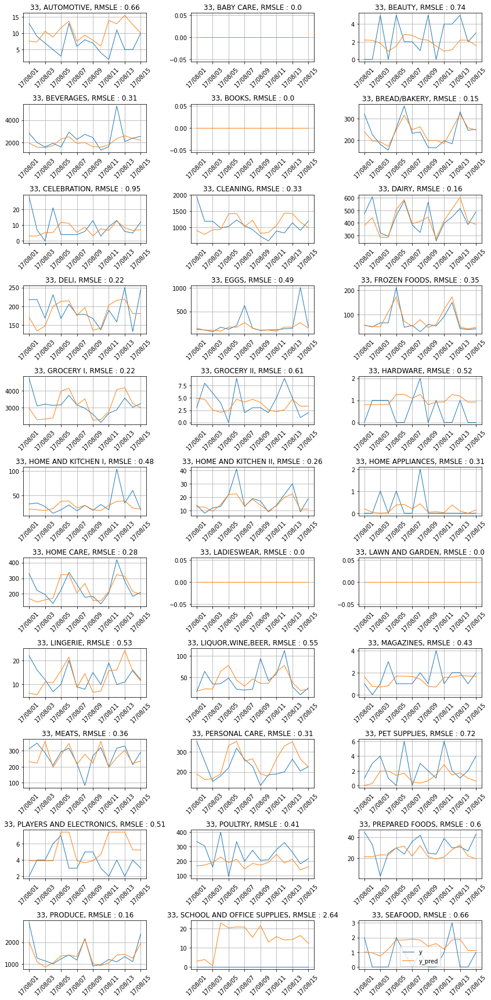

******************************


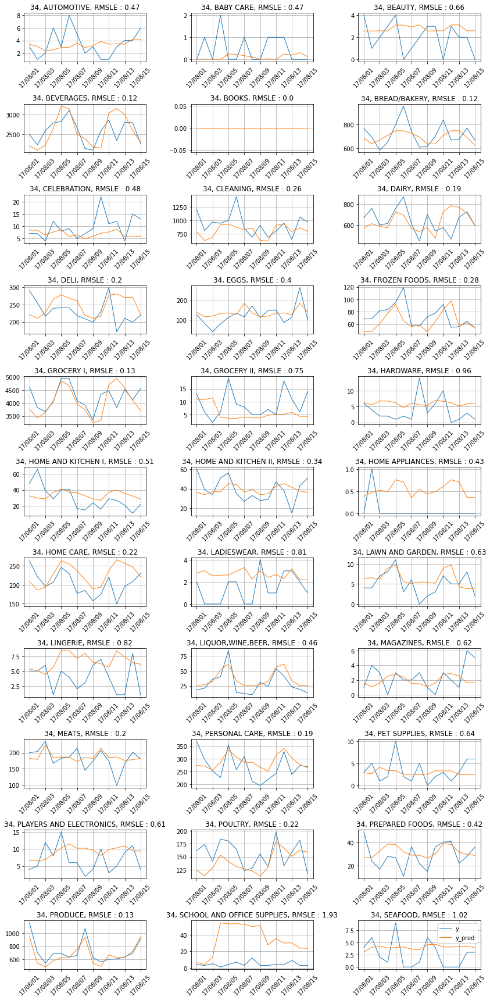

******************************


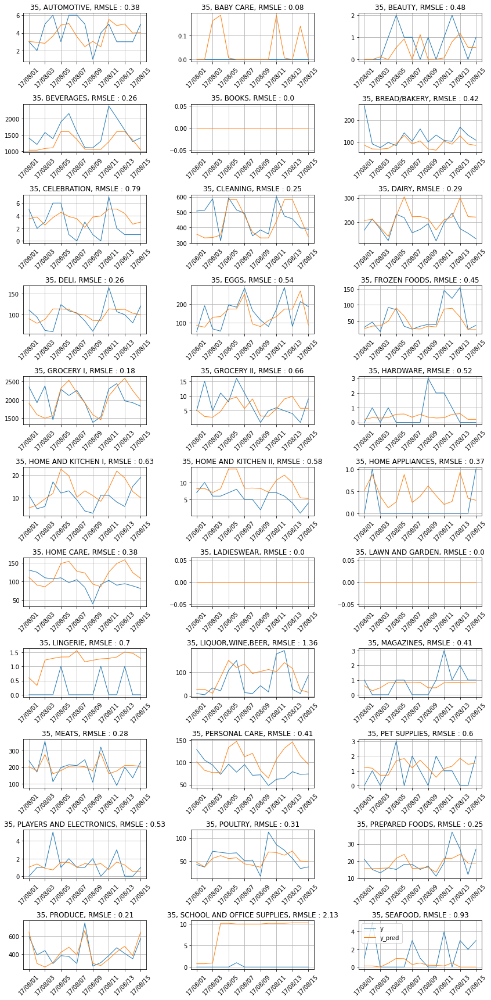

******************************


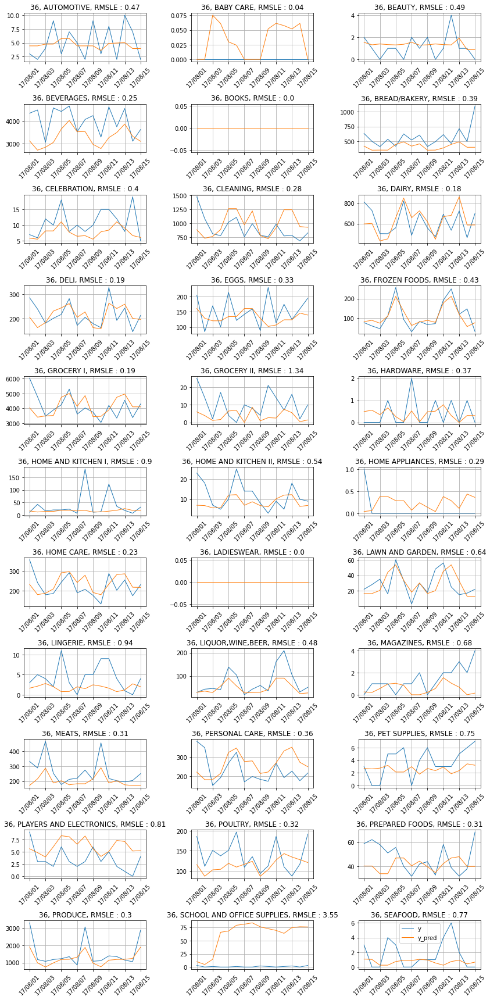

******************************


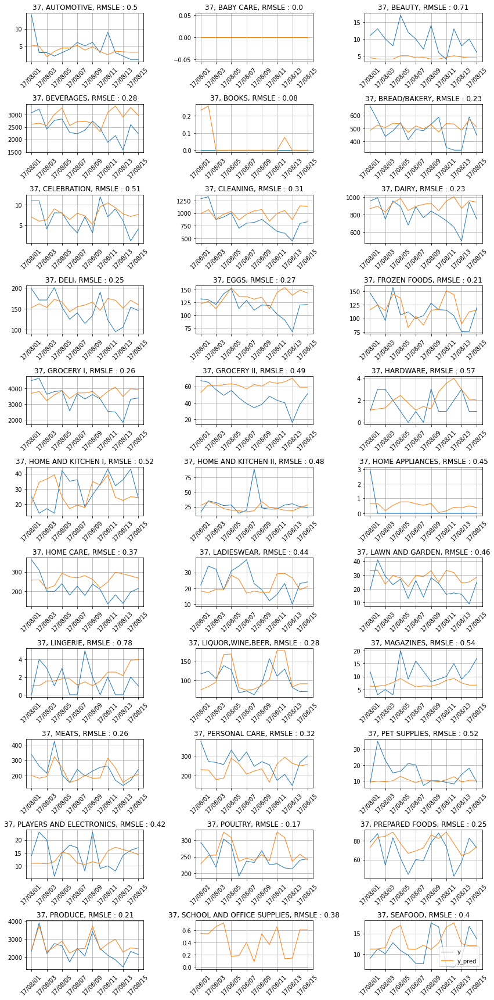

******************************


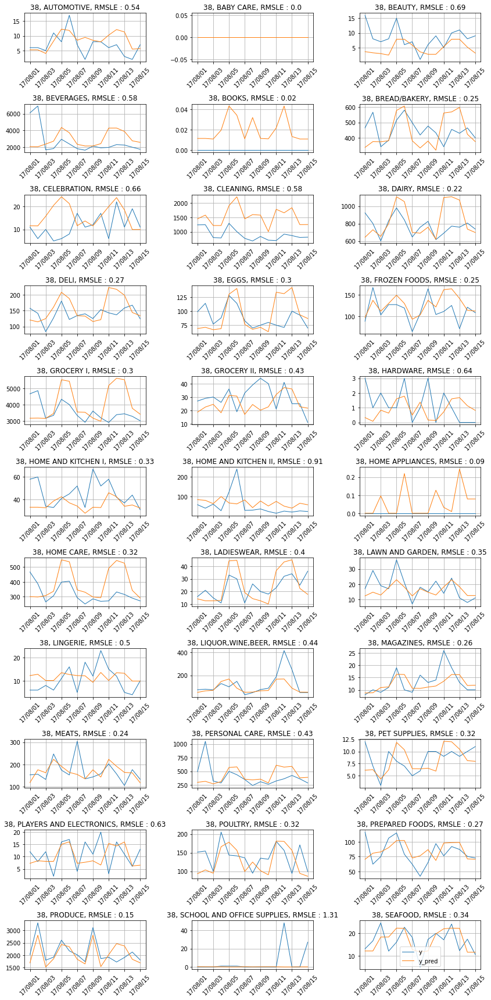

******************************


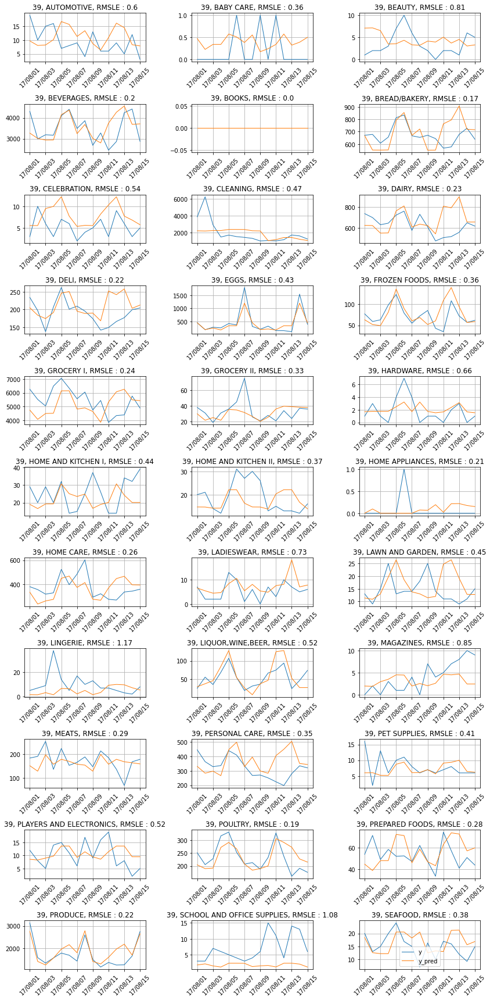

******************************


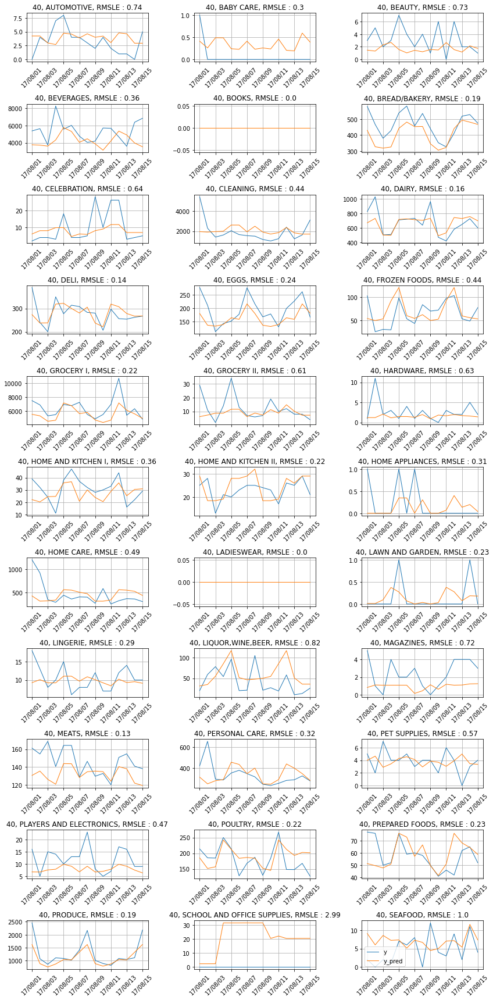

******************************


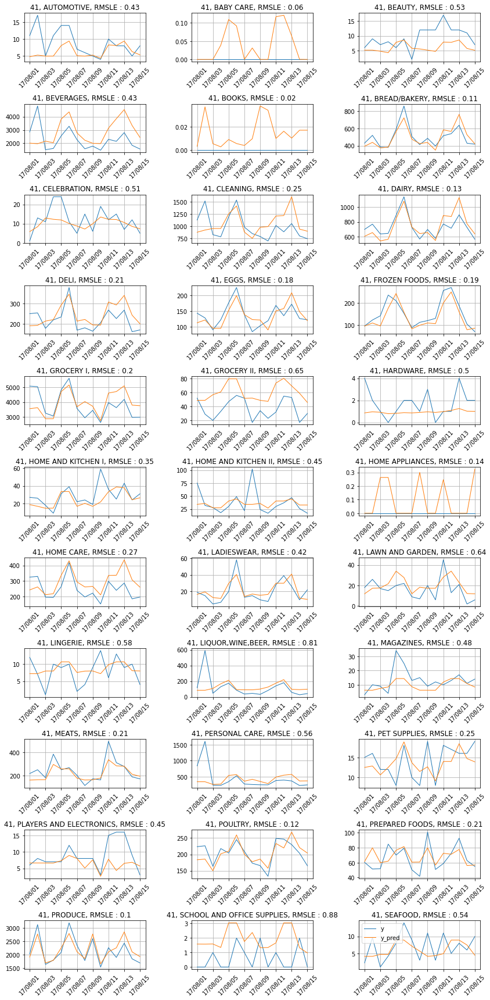

******************************


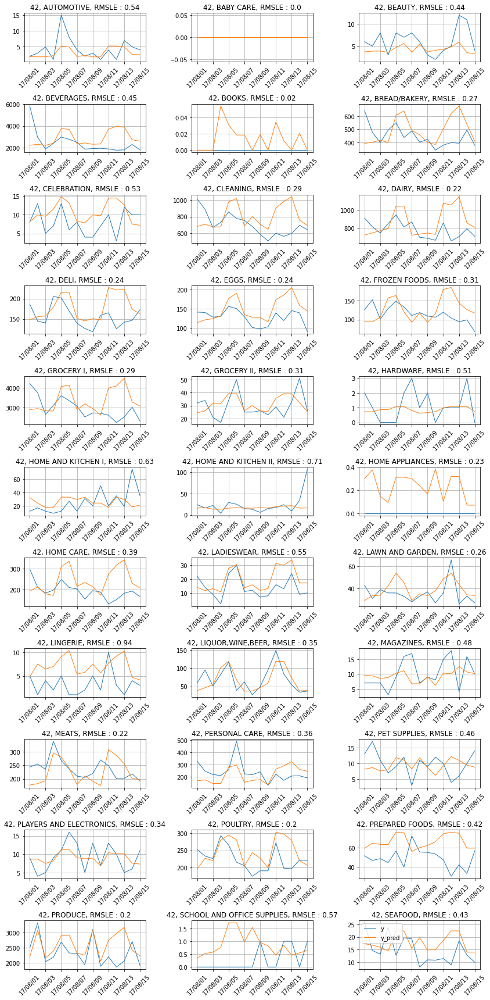

******************************


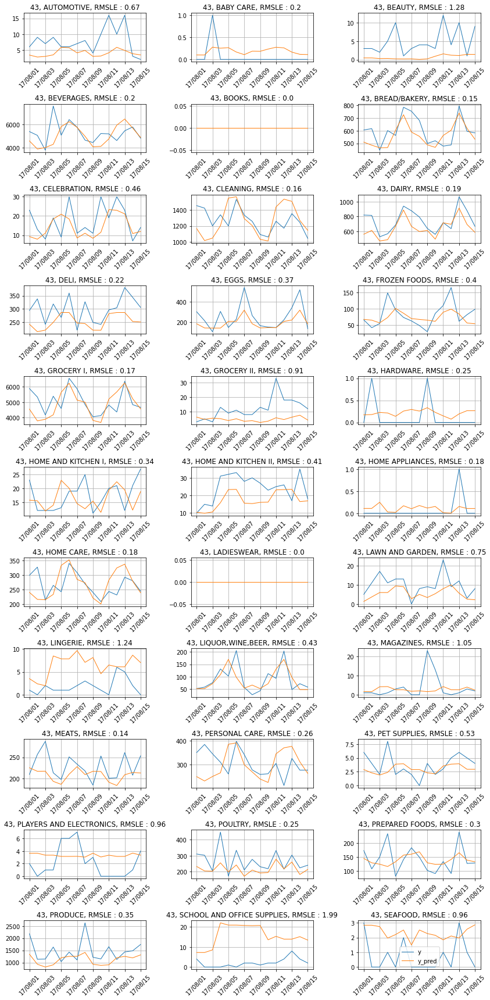

******************************


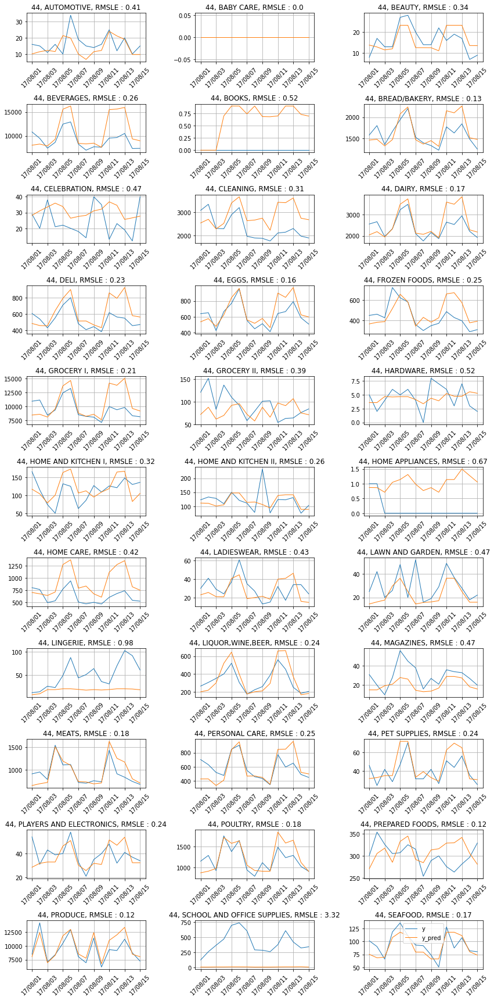

******************************


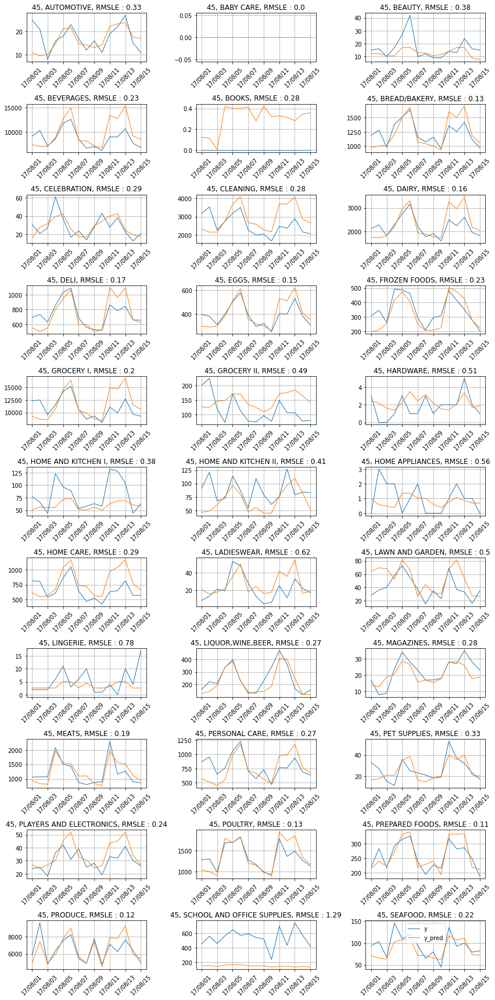

******************************


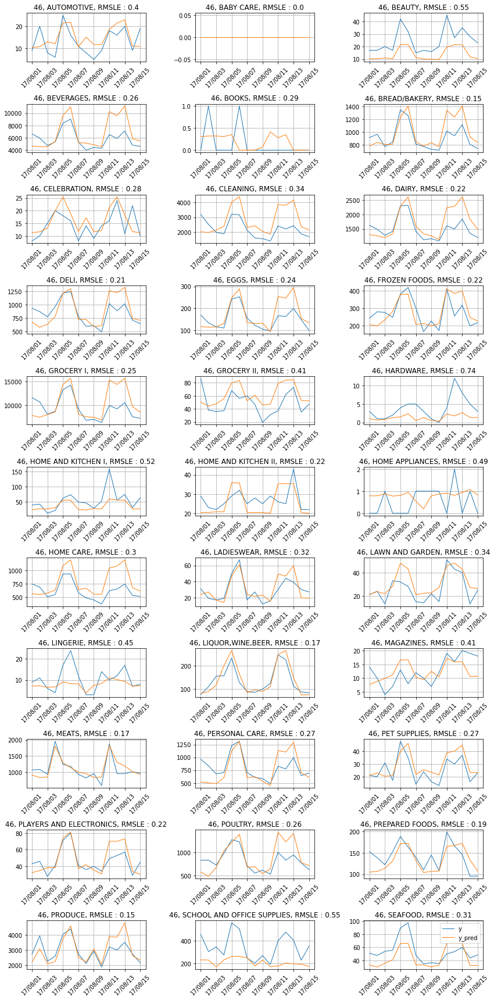

******************************


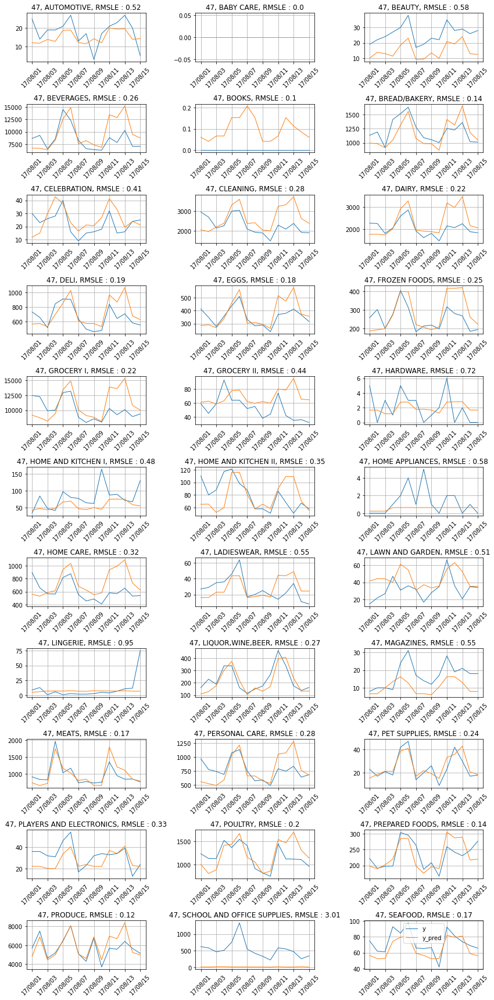

******************************


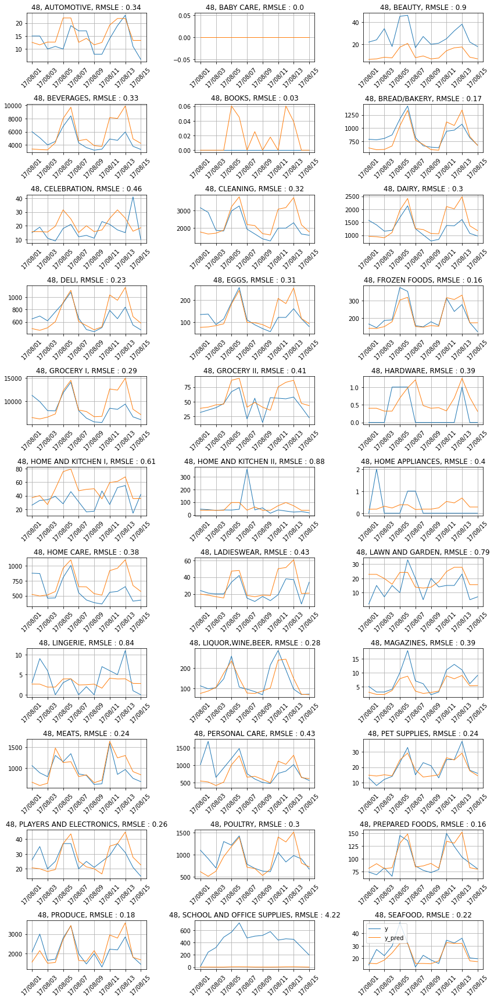

******************************


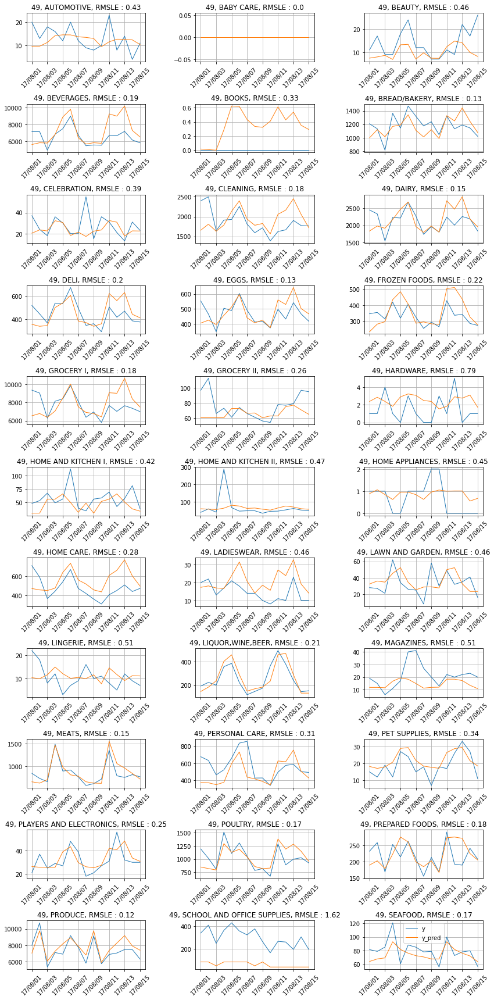

******************************


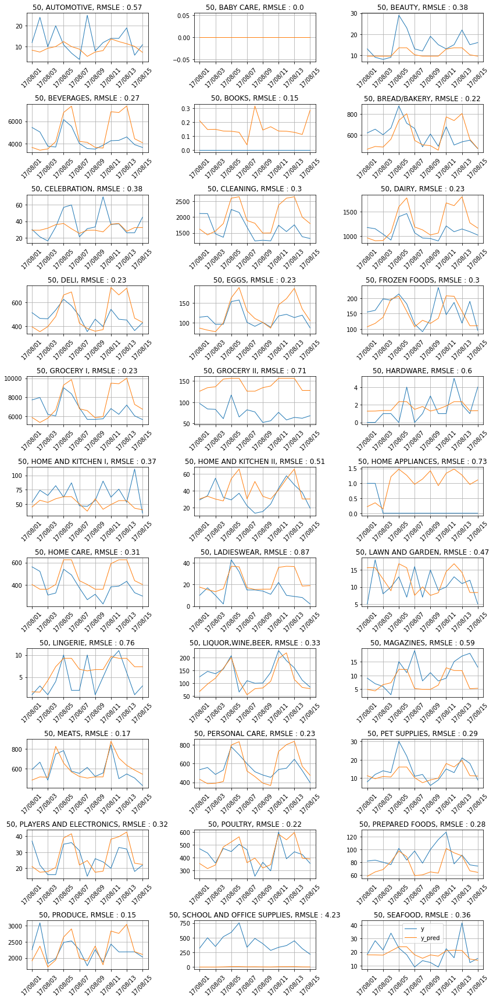

******************************


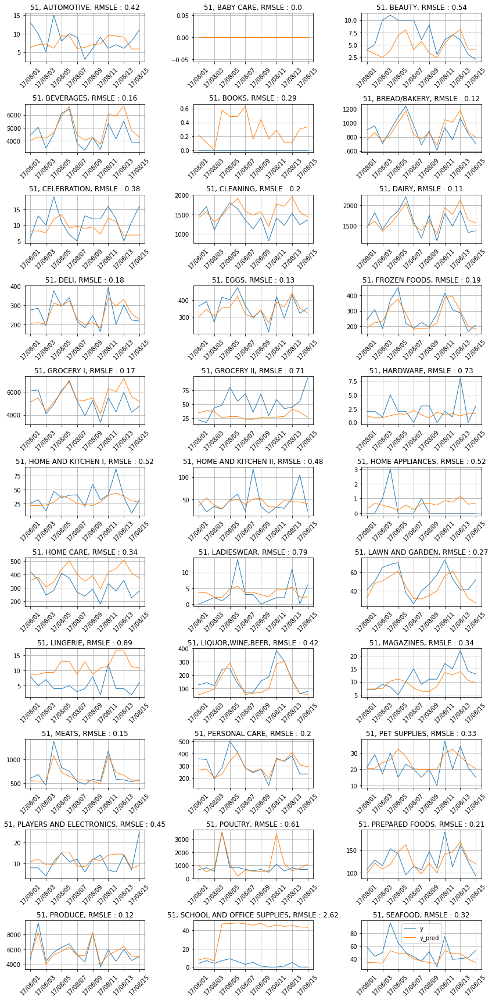

******************************


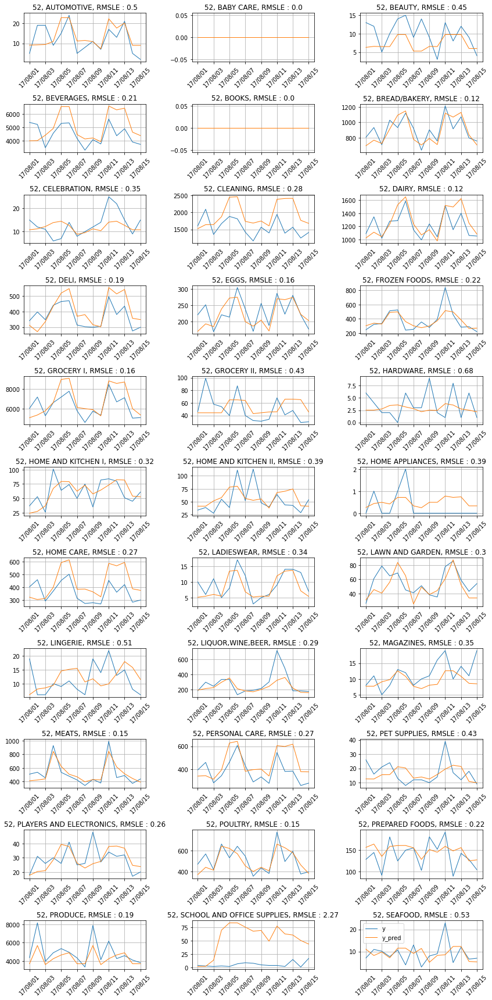

******************************


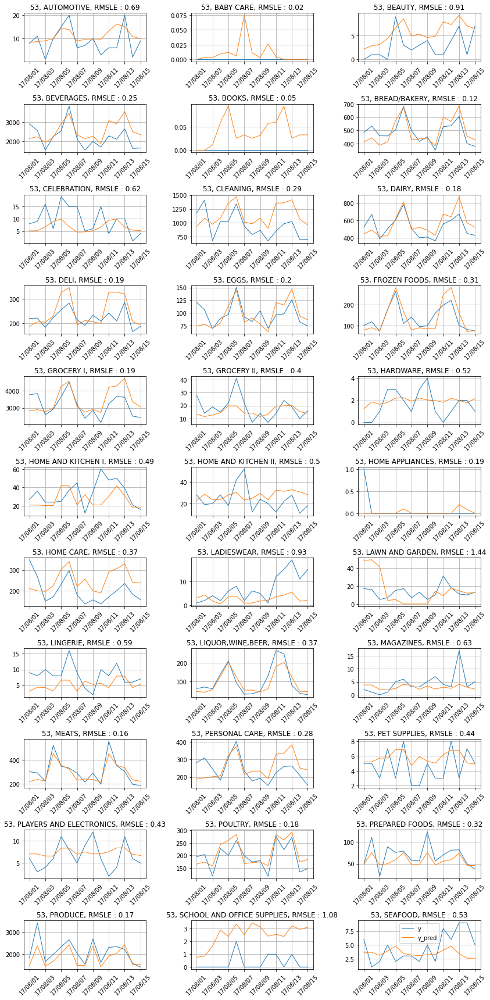

******************************


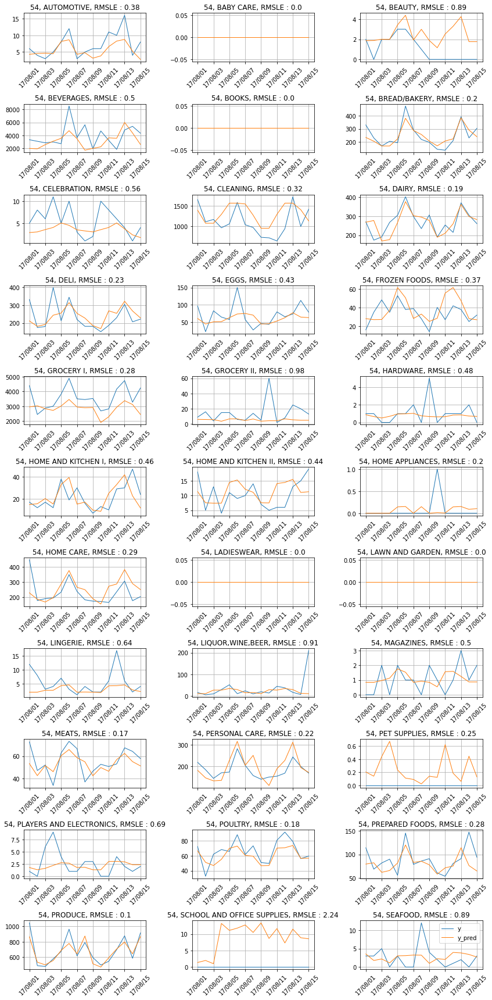

******************************


In [10]:
familys = df_result["family"].unique().tolist()
store_nbrs = df_result["store_nbr"].unique().tolist()
a = list(itertools.product(store_nbrs, familys))
params = df_result["params"].tolist()

train_start = conf["train_start"]
train_end = conf["train_end"]
test_start = conf["test_start"]
test_end = conf["test_end"]

#test = []
pre_nbr = 0
i = 1
test_rmsle = 0
test_result = []

for (nbr, family), param in zip(a, params):
  X = df_add_f.loc[train_start : train_end]
  y = df_train.loc[train_start : train_end].query(" (family==@family) & (store_nbr==@nbr) ").sales
  lgb_train = lgb.Dataset(X, y)
  model = lgb.train(
      param, lgb_train,
      verbose_eval=0,
      num_boost_round=1000,
  )
  y_true = df_train.loc[test_start : test_end].query(" (family==@family) & (store_nbr==@nbr) ").sales
  X_test = df_add_f.loc[test_start : test_end]
  y_pred = model.predict(X_test)
  y_pred[y_pred<0] = 0
  rmsle = mean_squared_log_error(y_true, y_pred, squared=False)
  test_rmsle += rmsle
  test_result.append([rmsle, family, nbr])

  x = y_true.index
  if pre_nbr != nbr:
    fig = plt.figure(figsize=(12, 24))
    i = 1
  #ax = fig.add_subplot(111)
  ax =fig.add_subplot(11, 3, i)
  ax.plot(x, y_true, linewidth=1.0, label="y")
  ax.plot(x, y_pred, linewidth=1.0, label="y_pred")
  ax.xaxis.set_major_formatter(DateFormatter("%y/%m/%d"))
  ax.set_title(f"{nbr}, {family}, RMSLE : {np.round(rmsle, 2)}")
  plt.xticks(rotation=45)
  plt.grid()
  i += 1
  if i == 34:
    fig.tight_layout()
    plt.legend()
    plt.show()
    print("***" * 10)
  pre_nbr = nbr

test_rmsle = test_rmsle / len(a)
plt.close()

In [11]:
df_result_test = pd.DataFrame(test_result)
df_result_test.columns = ["test_RMSLE", "family", "store_nbr"]
df_result = pd.merge(df_result, df_result_test, on=["family", "store_nbr"]).reindex(columns=["store_nbr", "family", "params", "val_RMSLE", "test_RMSLE"])
df_result.head()

,store_nbr,family,params,val_RMSLE,test_RMSLE
0,1,AUTOMOTIVE,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.638531,0.516507
1,1,BABY CARE,"{'max_bin': 100, 'boosting': 'gbdt', 'max_dept...",0.000000,0.000000
2,1,BEAUTY,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.463600,0.569828
3,1,BEVERAGES,"{'max_bin': 100, 'boosting': 'gbdt', 'max_dept...",0.279483,0.231818
4,1,BOOKS,"{'max_bin': 300, 'boosting': 'dart', 'max_dept...",0.429000,0.235588


In [12]:
print(df_result["test_RMSLE"].mean())
df_result.groupby(["family"]).mean().sort_values("test_RMSLE", ascending=False)

0.4186797590274922


,store_nbr,val_RMSLE,test_RMSLE
family,,,
SCHOOL AND OFFICE SUPPLIES,27.5,0.516136,1.753490
LINGERIE,27.5,0.649488,0.699723
GROCERY II,27.5,0.576332,0.642257
BEAUTY,27.5,0.546765,0.601799
HARDWARE,27.5,0.538371,0.560634
AUTOMOTIVE,27.5,0.534648,0.547927
CELEBRATION,27.5,0.593309,0.539961
MAGAZINES,27.5,0.524580,0.534750
SEAFOOD,27.5,0.531396,0.504217


In [13]:
# 提出用のcsvを作るために、idと(date, store_nbr, family)を紐づける辞書を作る
dates = df_test.index.tolist()
familys = df_test["family"].tolist()
store_nbrs = df_test["store_nbr"].tolist()
ids = df_test["id"].tolist()
id_dic = dict()

for date, nbr, family, id in zip(dates, store_nbrs, familys, ids):
  if (date, nbr, family) not in id_dic:
    id_dic[(date, nbr, family)] = id

In [14]:
familys = df_result["family"].unique().tolist()
store_nbrs = df_result["store_nbr"].unique().tolist()
a = list(itertools.product(store_nbrs, familys))
params = df_result["params"].tolist()

subtrain_start = conf["sub-train_start"]
subtrain_end = conf["sub-train_end"]
sub_start = conf["sub_start"]
sub_end = conf["sub_end"]

df_sub = pd.DataFrame()

for (nbr, family), param in zip(a, params):
  X = df_add_f.loc[subtrain_start : subtrain_end]
  y = df_train.loc[subtrain_start : subtrain_end].query(" (family==@family) & (store_nbr==@nbr) ").sales

  lgb_train = lgb.Dataset(X, y)
  model = lgb.train(
      param, lgb_train,
      verbose_eval=0,
      num_boost_round=1000,
  )
  X_sub = df_add_f.loc[sub_start : sub_end]
  y_sub = model.predict(X_sub)
  # date, nbr, familyでsubmission用のidを取り出す
  ids = [id_dic[(date, nbr, family)] for date in X_sub.index.tolist()]
  _sub = pd.DataFrame({"id" : ids, "sales" : y_sub})
  df_sub= pd.concat([df_sub, _sub])
df_sub = df_sub.sort_values(["id"])

In [15]:
df_sub.head()

,id,sales
0,3000888,3.341821
0,3000889,0.000000
0,3000890,4.041330
0,3000891,2215.863840
0,3000892,0.118917


In [17]:
model_name = "LightGBM"
filename = datetime.now().strftime(format="%y%m%d%H%M") + '_' + model_name

df_result.to_csv(f"result/{filename}.csv", index=None)
df_sub.to_csv(f"submission/{filename}.csv", index=None)

In [22]:
df_top = pd.read_csv("result/2209141538_Ridge_log.csv")

In [23]:
df_top.head()

,store_nbr,family,params,val_RMSLE,test_RMSLE
0,1,AUTOMOTIVE,{'alpha': 10},0.622882,0.509385
1,1,BABY CARE,{'alpha': 0.01},0.000000,0.000000
2,1,BEAUTY,{'alpha': 10},0.482125,0.558789
3,1,BEVERAGES,{'alpha': 0.1},0.248547,0.224953
4,1,BOOKS,{'alpha': 0.01},0.448476,0.178970


In [25]:
print(len(df_result))
print(len(df_result[df_result["test_RMSLE"] < df_top["test_RMSLE"]]))

1782
822


In [29]:
z = df_result[df_result["test_RMSLE"] < df_top["test_RMSLE"]]
z.value_counts(["famlily"])

family                    
PRODUCE                       50
MEATS                         44
POULTRY                       35
LIQUOR,WINE,BEER              32
HARDWARE                      31
FROZEN FOODS                  30
PREPARED FOODS                30
BREAD/BAKERY                  29
HOME AND KITCHEN II           28
PLAYERS AND ELECTRONICS       28
SEAFOOD                       28
CELEBRATION                   28
EGGS                          27
HOME APPLIANCES               27
MAGAZINES                     27
PET SUPPLIES                  26
LINGERIE                      26
DAIRY                         26
DELI                          26
BEVERAGES                     25
AUTOMOTIVE                    25
BEAUTY                        24
HOME AND KITCHEN I            23
SCHOOL AND OFFICE SUPPLIES    23
HOME CARE                     21
GROCERY II                    18
GROCERY I                     17
CLEANING                      16
LADIESWEAR                    14
BABY CARE       

In [33]:
z = df_result[df_result["val_RMSLE"] < df_top["val_RMSLE"]]
z.value_counts(["family"])

family                    
HARDWARE                      42
HOME APPLIANCES               42
AUTOMOTIVE                    31
HOME AND KITCHEN II           31
MAGAZINES                     30
LINGERIE                      30
GROCERY II                    29
PLAYERS AND ELECTRONICS       28
PET SUPPLIES                  26
SEAFOOD                       26
BABY CARE                     25
HOME AND KITCHEN I            23
BEAUTY                        23
PREPARED FOODS                22
SCHOOL AND OFFICE SUPPLIES    17
CELEBRATION                   15
MEATS                         13
GROCERY I                     12
CLEANING                      11
LADIESWEAR                    11
PERSONAL CARE                 11
DELI                          10
POULTRY                        9
BOOKS                          9
BREAD/BAKERY                   8
DAIRY                          8
HOME CARE                      7
LAWN AND GARDEN                5
BEVERAGES                      5
EGGS            

In [34]:
z = df_result[(df_result["val_RMSLE"] < df_top["val_RMSLE"]) & (df_result["test_RMSLE"] < df_top["test_RMSLE"])]
len(z)

269

In [35]:
z.value_counts(["family"])

family                    
HARDWARE                      24
HOME APPLIANCES               19
AUTOMOTIVE                    16
LINGERIE                      16
HOME AND KITCHEN II           15
MAGAZINES                     14
PLAYERS AND ELECTRONICS       13
PET SUPPLIES                  13
PREPARED FOODS                11
BABY CARE                     11
GROCERY II                    10
BEAUTY                        10
SEAFOOD                        9
CELEBRATION                    9
SCHOOL AND OFFICE SUPPLIES     9
MEATS                          9
HOME AND KITCHEN I             9
LADIESWEAR                     6
DAIRY                          6
BREAD/BAKERY                   5
BEVERAGES                      4
GROCERY I                      4
DELI                           4
POULTRY                        4
LAWN AND GARDEN                3
FROZEN FOODS                   3
EGGS                           3
CLEANING                       3
BOOKS                          2
PERSONAL CARE   

In [36]:
df_result.to_csv(f"result/_top_submission.csv", index=None)

In [39]:
df_top = pd.read_csv("result/2209141538_Ridge_log.csv")

In [40]:
df_top.head()

,store_nbr,family,params,val_RMSLE,test_RMSLE
0,1,AUTOMOTIVE,{'alpha': 10},0.622882,0.509385
1,1,BABY CARE,{'alpha': 0.01},0.000000,0.000000
2,1,BEAUTY,{'alpha': 10},0.482125,0.558789
3,1,BEVERAGES,{'alpha': 0.1},0.248547,0.224953
4,1,BOOKS,{'alpha': 0.01},0.448476,0.178970
